# Korisnička dokumentacija

## Instalacija

Projektno rješenje pisano je u programskom jeziku Python 3 koristeći čitav niz pomoćnih biblioteka (Tensorflow, scikit-learn, scikit-image…).

U direktoriju s izvornim kodom nalazi se datoteka `requirements.txt` koja sadrži popis potrebnih biblioteka.
Preporuka je da koristite virtual environment za njihovu instalaciju.

Instalacija virtualenv:
```sh
pip3 install virtualenv
```


Stvaranje novog virtualnog okruženja
```sh
virtualenv -p /usr/bin/python3 mozgalo
```


Aktivacija stvorenog virtualnog okruženja
```sh
source ./mozgalo/bin/activate
```


Instalacija svih potrebnih paketa:
```sh
pip3 install -r /requirements.txt

```  
-----
## Skupovi podataka

Korišteno je nekoliko javno dostupnih skupova podataka za evaluaciju rješenja:
 - [cifar10](https://www.cs.toronto.edu/~kriz/cifar.html)
 - [stl10](http://cs.stanford.edu/~acoates/stl10/)
 - [Cats_vs_dogs](https://www.kaggle.com/c/dogs-vs-cats)
 
Kako bi pojednostavnili skidanje i pohranu svih skupova podataka potrebnih za reproduciranje rezultata pripremili smo jednu arhivu koja sadrži sve potrebno na sljedećoj [poveznici](https://www.dropbox.com/s/7ui2a58md0zvhep/dataset.tar.gz?dl=0). Dobivenu arhivu raspakirati u korijenski direktorij projekta.
```sh
wget wget -O dataset.tar.gz 'https://www.dropbox.com/s/7ui2a58md0zvhep/dataset.tar.gz?dl=0'
tar xvf dataset.tar.gz
```
-----
## Pokretanje
U direktoriju `notebooks` nalazi se jupyter bilježnica s cjelovitim rješenjem.
```sh
cd notebooks
jupyter notebook final_report.ipynb
```
Odlučili smo se za korištenje python bilježnice radi jednostavnosti korištenja, pogodnosti za demonstraciju rezultata, laganog uređivanja i eksperimentiranja nad rezultatima. 

U samoj bilježnici slijedno je prikazan postupak:
- učitavanje podataka
- izlučivanje značajki
- odabir optimalne dimenzije značajki i redukcija dimenzionalnosti 
- odabir optimalnog broja grupa i samo grupiranje
- prikaz rezultata
- provjera rezultata nad označenim skupovima podataka 


----
## Struktura direktorija
- `dataset` - direktorij sa skupovima podataka
- `notebooks` - korištene Jupyter bilježnice
- `models` - prethodno trenirani TensorFlow modeli korišteni za ekstrakciju značajki
- `report_imgs` - slike korištene u dokumentaciji
- `clusters` - dobiveni rezultati grupiranja
- `src` - direktorij s izvornim kodom
- `src/modules/external` - git submodule iz paketa `slim` i `keras` za korištenje gotovih prethodno treniranih mreža 

____
Priloženo programsko rješenje je isprobano pod Linux okruženjem (Ubuntu 16.04 i Arch Linux). 
Ako naiđete na ikakav problem prilikom pokretanja, molimo Vas da se javite nekom od članova tima kako bi otklonili moguće poteškoće.


In [3]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import os
import sys
import os
import sys

import numpy as np
import tensorflow as tf
import pandas as pd
from glob import glob
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import skimage
import skimage.io

%matplotlib inline

print('sys_version', sys.version.replace('\n', ''))
print('virtual_env', os.environ.get('VIRTUAL_ENV', 'None'))
print('pwd', os.getcwd())
print('np ', np.__version__)
print('tf ', tf.__version__)

# fix import src problem
sys.path.append('..')
from src.modules.dataset import *
from src.modules.dataset_utils import *
sns.set_style("whitegrid", {'axes.grid' : False})

sys_version 3.5.2 (default, Nov 17 2016, 17:05:23) [GCC 5.4.0 20160609]
virtual_env /home/marko/.virtualenvs/mozgalo
pwd /home/marko/Projects/mozgalo2017/notebooks
np  1.12.1
tf  1.1.0


# Mozgalo

## Datasets

In [4]:
from src.modules.dataset import *
from src.modules.dataset_utils import *

# print datasets and paths
for name, path in dataset_imgs_root.items():
    
    print('Dataset %s\n\tpath:%s\n\texists?: %s\n' % (name, 
                                                      os.path.abspath(path), 
                                                      os.path.exists(path)))

Dataset cats_dogs
	path:/home/marko/Projects/mozgalo2017/dataset/cats_dogs/imgs
	exists?: True

Dataset stl10
	path:/home/marko/Projects/mozgalo2017/dataset/stl10/imgs
	exists?: True

Dataset mozgalo
	path:/home/marko/Projects/mozgalo2017/dataset/mozgalo_dataset/imgs
	exists?: True

Dataset cifar10
	path:/home/marko/Projects/mozgalo2017/dataset/cifar10/imgs
	exists?: True



## Dataset examples


Dataset: cats_dogs, n_samples: 25000, n_classes: 2


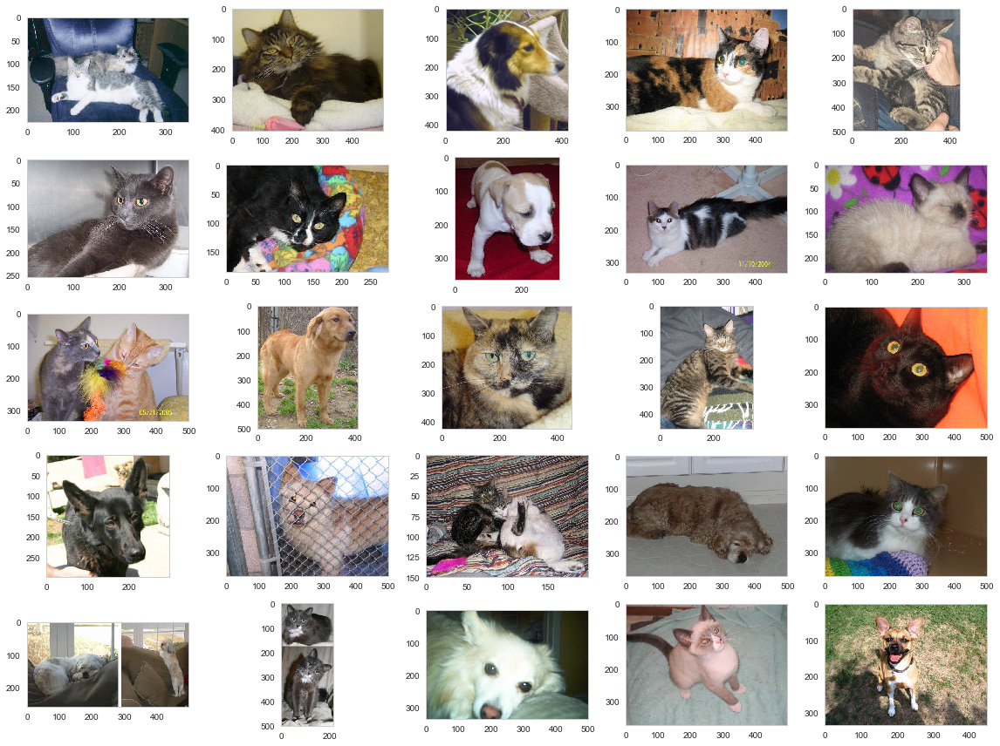


Dataset: stl10, n_samples: 5000, n_classes: 10


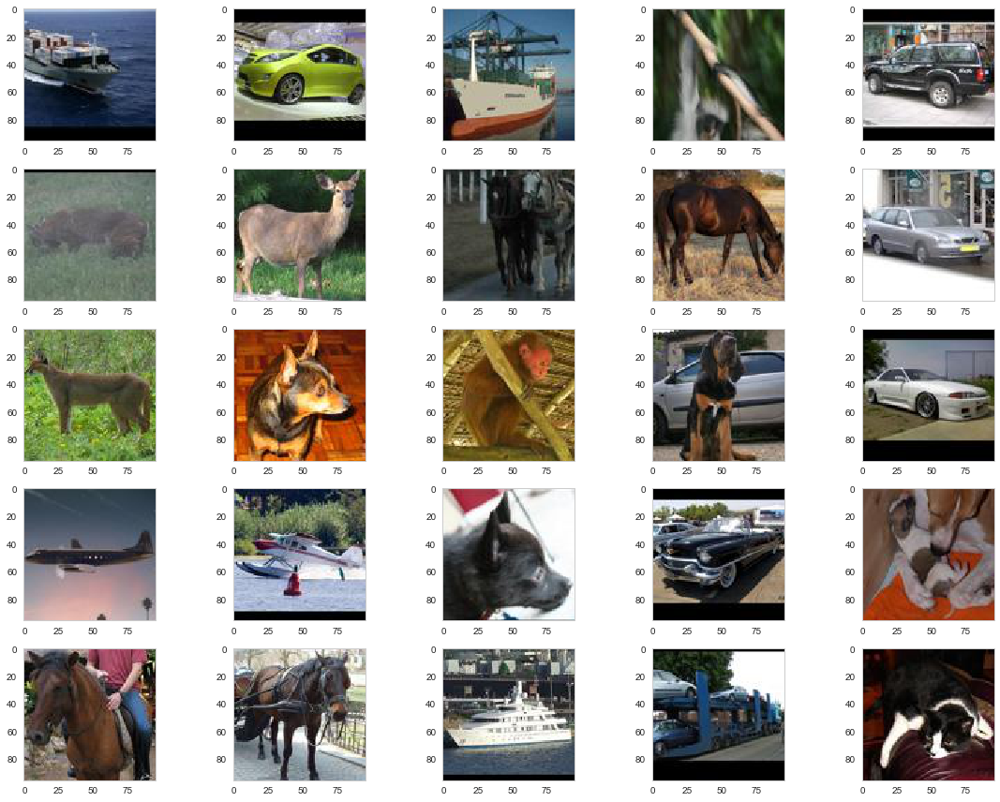


Dataset: mozgalo, n_samples: 6889, n_classes: unknown


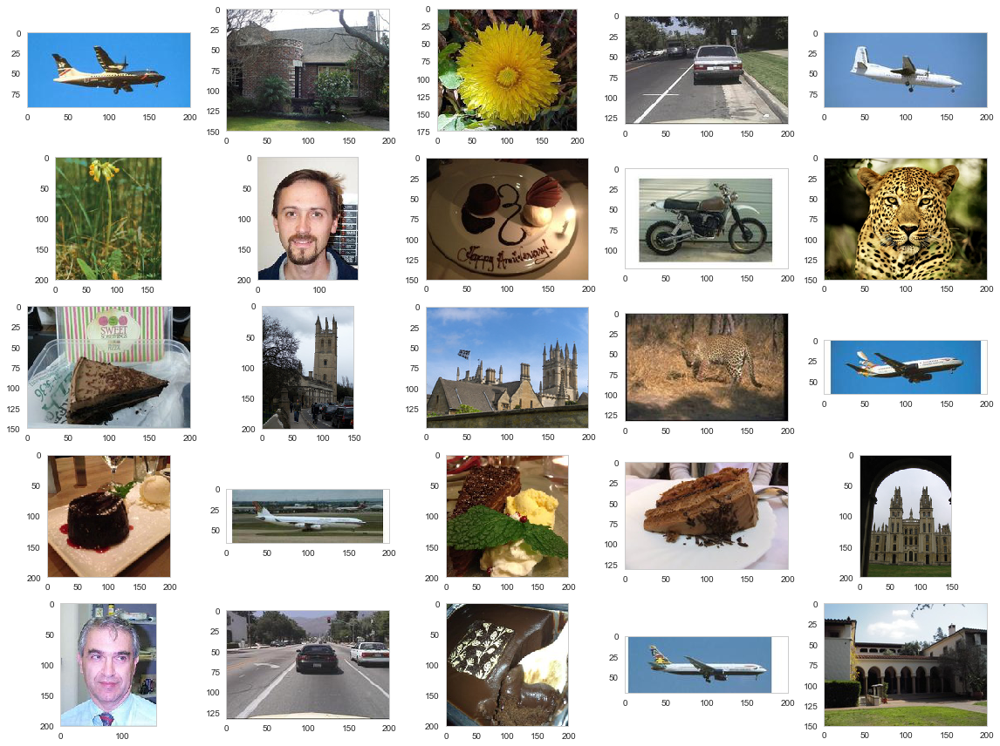


Dataset: cifar10, n_samples: 50000, n_classes: 10


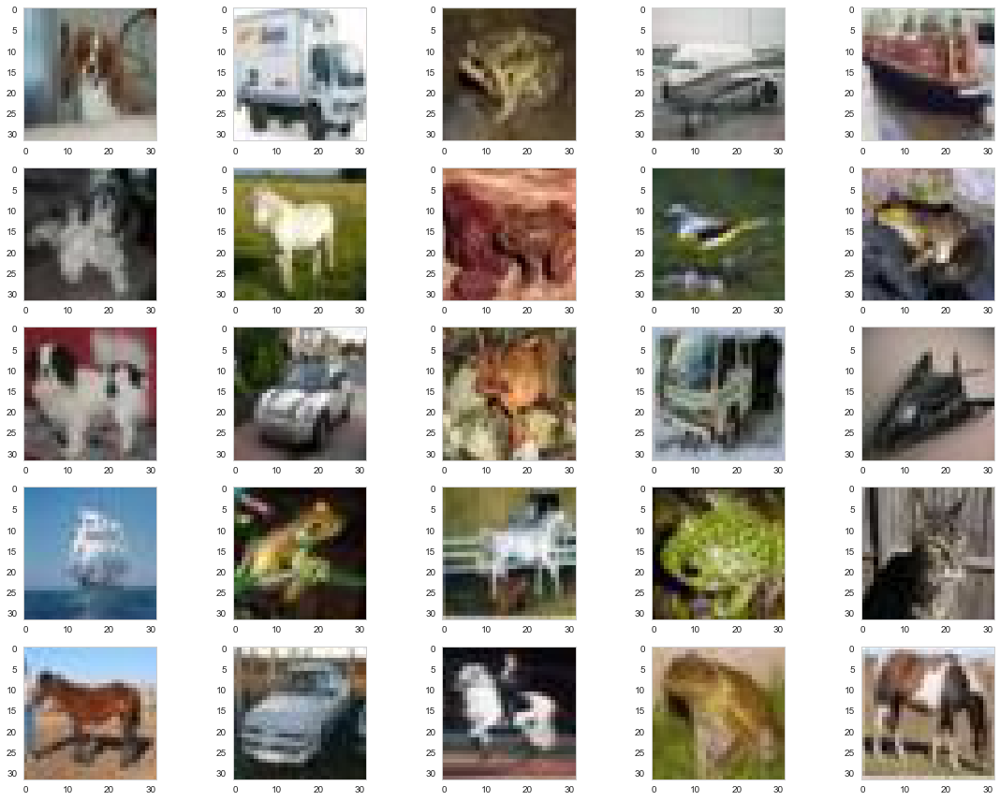

In [6]:
for name, path in dataset_imgs_root.items():
    n_samples = len(os.listdir(path))
    different_classes = get_n_different_classes(name)
    
    print()    
    print("Dataset: %s, n_samples: %s, n_classes: %s" % (name, n_samples, different_classes))
    show_random_sample(path)
    plt.show()

## Loading dataset

In [7]:
from src.modules.feature_extractors import inceptionv3, inceptionv4, resnet50
from src.modules.utils import *
from src.modules.dataset import *
init_logging()

# Loading dataset
dataset_name = 'mozgalo'

# to use new dataset just pass path to the root directory containing images
# in the constructor
dataset = ImageDataset(dataset_imgs_root[dataset_name])


Using TensorFlow backend.


## Feature extraction

Define network used to extract features
Implemented options:
 - inceptionv3.InceptionNet()
 - inceptionv4.InceptionNetV4()
 - resnet50.Resnet50()

In [8]:
features_extraction_model = inceptionv3.InceptionNet()
features_extraction_model.create_graph()

### Extracting features and dumping to file

Feature extraction is slow operation, after extraction features are dumped to drive so they can be reused later

In [9]:
# Features for selected dataset and selected model
# create if does not exist
# If using new dataset just provide desired location where extracted features
# are going to be cached for later usage
features_path = pickled_features_path(dataset_name, features_extraction_model)

if os.path.exists(features_path):
    logging.info("Reloading cached features")
    dataset.load_features(features_path)
else:
    logging.info("Features not found, extracting")
    dataset.extract_features(features_extraction_model)
    dataset.store_features(features_path)

# debug print caused by skimage when reading RGBA images

2017-05-19 20:36:57 INFO     Reloading cached features
2017-05-19 20:36:57 DEBUG    Loading imgs in dataset


100%|██████████| 6889/6889 [00:08<00:00, 827.02it/s]


## Feature extraction sanity check

- for given image find most similar images in dataset

100%|██████████| 1/1 [00:00<00:00,  1.53it/s]


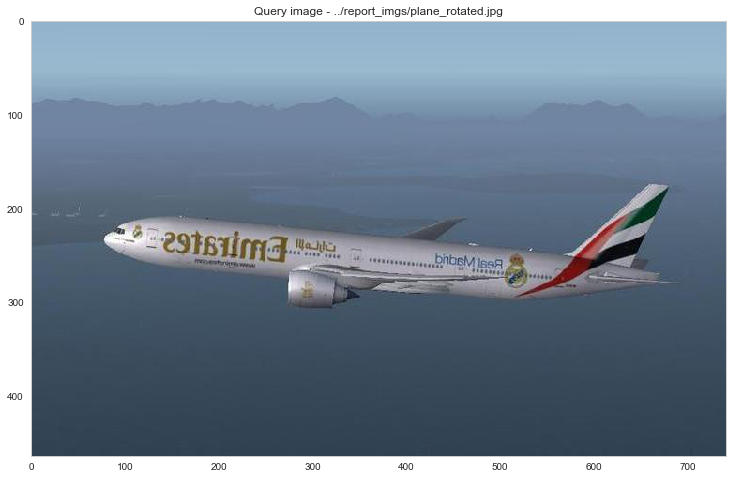

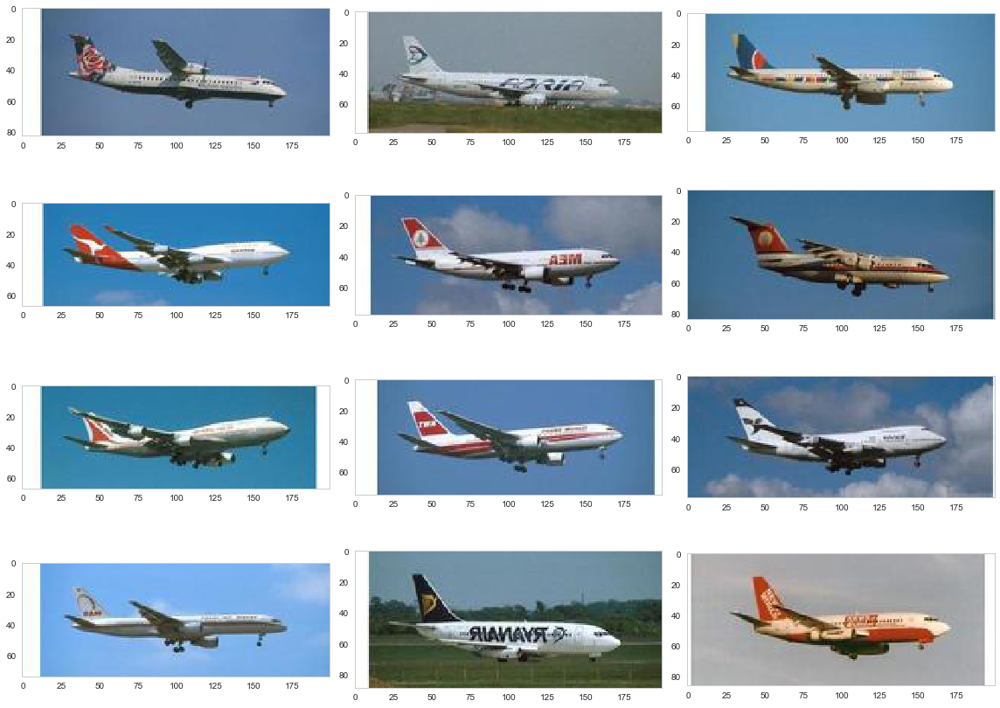

100%|██████████| 1/1 [00:00<00:00,  1.63it/s]


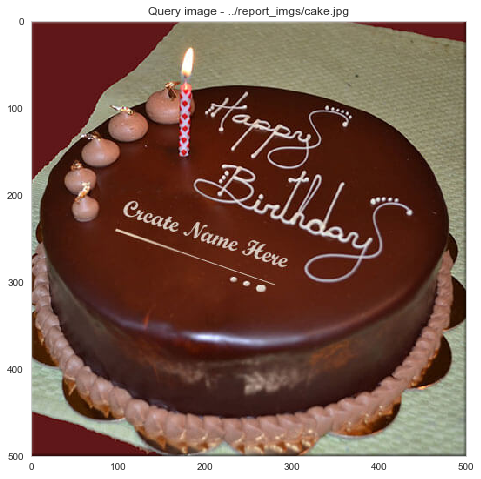

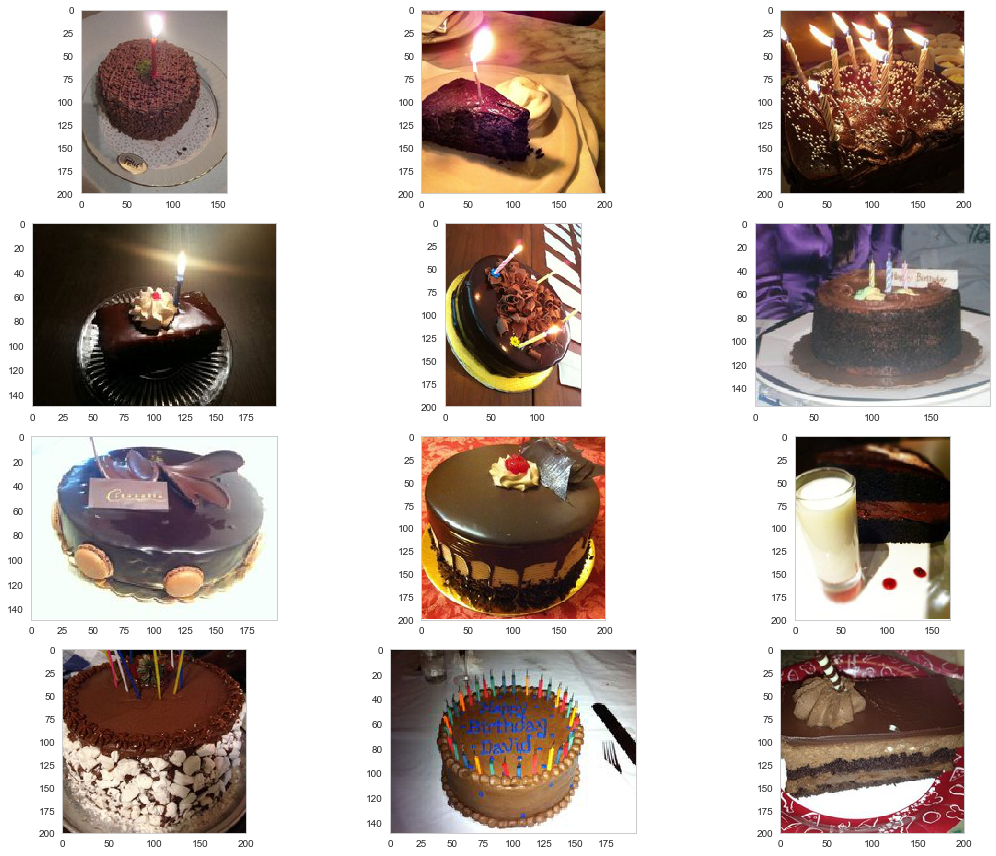

100%|██████████| 1/1 [00:00<00:00,  1.54it/s]


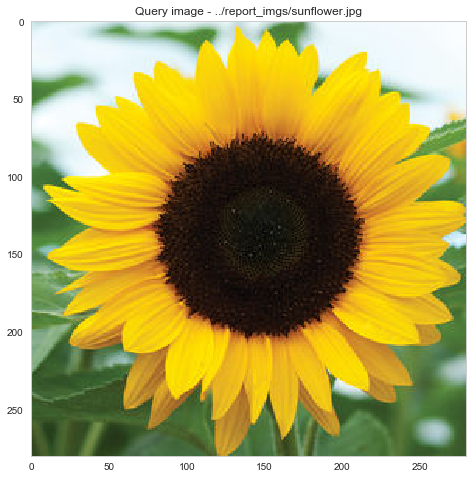

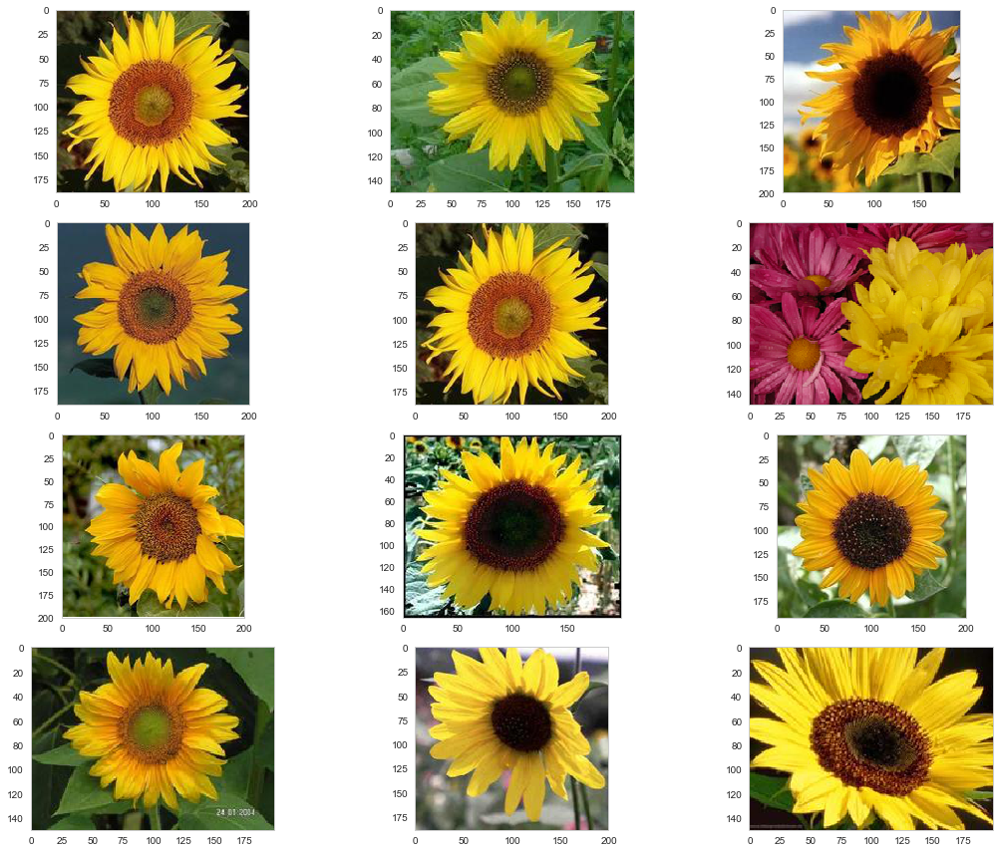

In [12]:
get_features = lambda x: features_extraction_model.extract_features([x])[0]

test_imgs = ['../report_imgs/plane_rotated.jpg', 
             '../report_imgs/cake.jpg', 
             '../report_imgs/sunflower.jpg']


for img in test_imgs:
    plot_closest_results(img, get_features, dataset)


## PCA

### Finding optimal number of dimensions

- reduce dimension of feature space
- several criteria functions are used (some automatic, some manual)

In [8]:
from sklearn.decomposition import PCA
features = PCA().fit(dataset.features)

# kaiser method for selectiong optimal number of dimensions
summary = pca_summary(features, dataset.features)
n_components = summary[summary.sdev**2 > 1].shape[0]
print("n_components:", n_components)

n_components: 22


In [18]:
# Percentage of variance explained leaves 80% variance in data
features = PCA(0.8).fit_transform(dataset.features)
n_components = features.shape[1]
print("n_components:", n_components)

n_components: 156


(50,) (50,)


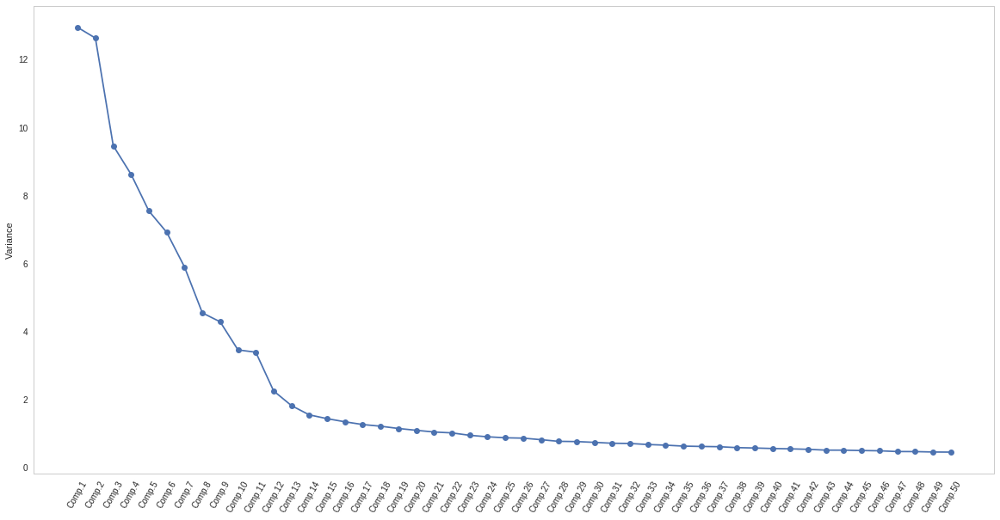

Unesite optimalan broj grupa(metoda lakta): 13
n_components: 13


In [9]:
# Manual method for optimal target dimension usig scree criteria
plt.figure(figsize=(20,10))
screeplot(features, dataset.features)
n_components = int(input("Unesite optimalan broj grupa(metoda lakta): "))
print("n_components:", n_components)

In [19]:
# transform features to lower dimensional space
features = PCA(n_components=n_components).fit_transform(dataset.features)

## Clustering

- KMean and AgglomerativeClustering are used
- Number of clusters determined by several scores (Silhouette score, Lalinski-Harabasz score...)


KMeans
Silhouette score
Number of cluster: 11
Scores: [[  2.           0.16379821]
 [  3.           0.21695343]
 [  4.           0.26062156]
 [  5.           0.31998761]
 [  6.           0.36727224]
 [  7.           0.40689822]
 [  8.           0.4635117 ]
 [  9.           0.50051816]
 [ 10.           0.53257022]
 [ 11.           0.53258615]
 [ 12.           0.51458002]
 [ 13.           0.49734842]
 [ 14.           0.49855695]
 [ 15.           0.47287873]]
time:45.49881148338318


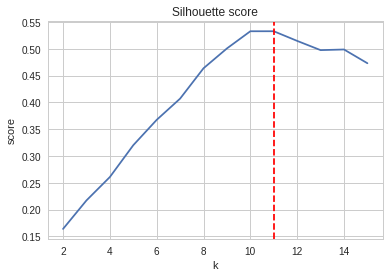

Calinski-Harabasz score
Number of cluster: 11
Scores: [[  2.00000000e+00   1.11078293e+03]
 [  3.00000000e+00   1.15277104e+03]
 [  4.00000000e+00   1.21561508e+03]
 [  5.00000000e+00   1.37334835e+03]
 [  6.00000000e+00   1.50899502e+03]
 [  7.00000000e+00   1.75773719e+03]
 [  8.00000000e+00   1.93797887e+03]
 [  9.00000000e+00   2.28097673e+03]
 [  1.00000000e+01   2.57652516e+03]
 [  1.10000000e+01   2.80236898e+03]
 [  1.20000000e+01   2.78335214e+03]
 [  1.30000000e+01   2.76004871e+03]
 [  1.40000000e+01   2.72521443e+03]
 [  1.50000000e+01   2.65769040e+03]]
time:27.14028549194336


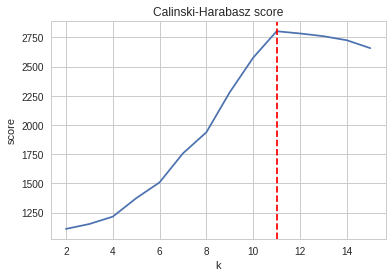


AgglomerativeClustering
Silhouette score
Number of cluster: 11
Scores: [[  2.           0.1621466 ]
 [  3.           0.21508387]
 [  4.           0.26754471]
 [  5.           0.3126278 ]
 [  6.           0.3551131 ]
 [  7.           0.40133075]
 [  8.           0.45797693]
 [  9.           0.4953383 ]
 [ 10.           0.52603365]
 [ 11.           0.52603583]
 [ 12.           0.49582141]
 [ 13.           0.47377   ]
 [ 14.           0.47429092]
 [ 15.           0.4441527 ]]
time:46.143046379089355


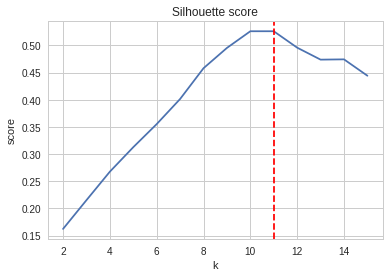

Calinski-Harabasz score
Number of cluster: 11
Scores: [[  2.00000000e+00   1.10486304e+03]
 [  3.00000000e+00   1.17465484e+03]
 [  4.00000000e+00   1.25448141e+03]
 [  5.00000000e+00   1.35387087e+03]
 [  6.00000000e+00   1.49721875e+03]
 [  7.00000000e+00   1.69811006e+03]
 [  8.00000000e+00   1.99445005e+03]
 [  9.00000000e+00   2.23917542e+03]
 [  1.00000000e+01   2.51625086e+03]
 [  1.10000000e+01   2.66665170e+03]
 [  1.20000000e+01   2.59784174e+03]
 [  1.30000000e+01   2.55483354e+03]
 [  1.40000000e+01   2.50529949e+03]
 [  1.50000000e+01   2.45221543e+03]]
time:27.59770703315735


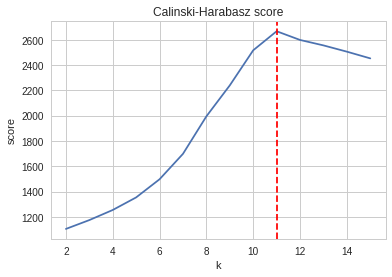

In [14]:
from sklearn.cluster.spectral import SpectralClustering
from sklearn.cluster import KMeans, AgglomerativeClustering
from src.modules.clustering_scores import *
from sklearn.preprocessing import StandardScaler
import time
from operator import itemgetter
import matplotlib.pyplot as plt
import numpy as np


features = PCA(n_components).fit_transform(dataset.features)
cluster_estimators = [KMeans(n_jobs=-1), AgglomerativeClustering()]
selected_nb_clusters = 0

for cluster_estimator in cluster_estimators:
    print()
    print(str(cluster_estimator).split('(')[0])
    for name, func_choose_nb_cluster in {
        'Silhouette score': max_silhouette,
        'Calinski-Harabasz score': max_CH_index
        # methds below are computationaly expensive
        #'Stability': stability,
        #'Gap statistic': gap_statistic,
    }.items():
        # predict cluster memberships
        t0 = time.time()
        nb_cluster, k_score = func_choose_nb_cluster(features, cluster_estimator, k_max=15)
        t1 = time.time()

        print("="*80)
        print(name)
        print("Number of cluster: %d" % nb_cluster)
        print("Scores: ", end='')
        print(k_score)
        print('time:', end='')
        print(t1-t0)

        plt.title(name)
        plt.xlabel("k")
        plt.ylabel("score")
        plt.plot(range(2,16), k_score[:,1])
        plt.axvline(nb_cluster, c='r', ls='--')
        plt.grid()
        plt.show()

        selected_nb_clusters = max(selected_nb_clusters, nb_cluster)


In [21]:
# Use KMeans with previously found number of clusters

cluster_model = KMeans(n_jobs=-1)
cluster_model = KMeans(n_clusters=selected_nb_clusters)
cluster_model.fit(features)
out_dir = os.path.join(CLUSTER_OUT_ROOT, 'final_results')
dataset.save_clusters_to_file(out_dir, cluster_model.labels_)

 64%|██████▎   | 7/11 [00:13<00:06,  1.72s/it]/home/mratkovic/mozgalo/lib/python3.5/site-packages/skimage/util/dtype.py:122: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))
100%|██████████| 11/11 [00:19<00:00,  1.44s/it]


## Show results

Computing t-SNE embedding
Ploting...


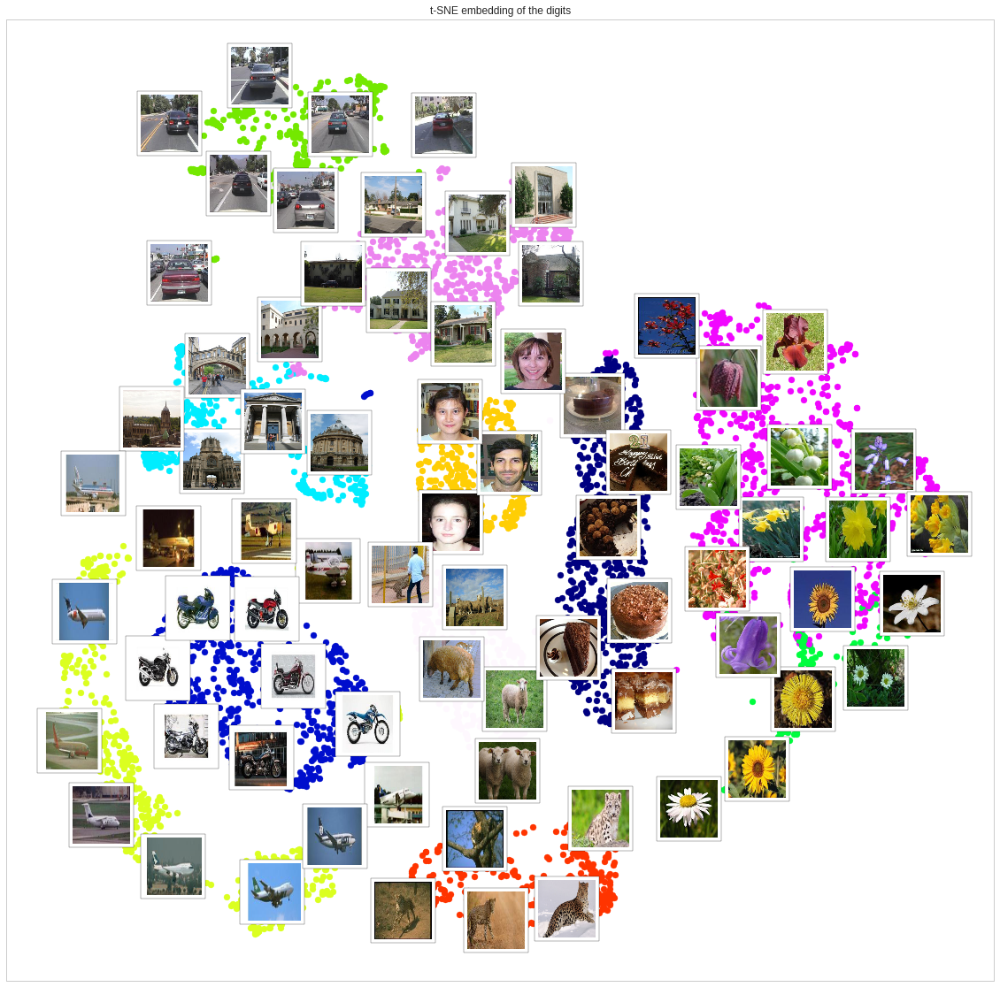

In [19]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from time import time
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import offsetbox
from sklearn import (manifold, datasets, decomposition, ensemble, discriminant_analysis, random_projection)
from src.modules import dataset_utils as du

import warnings
warnings.filterwarnings('ignore')

ag = KMeans(11,n_jobs=-1)
aaa = PCA(22).fit_transform(dataset.features)
labels = ag.fit_predict(aaa)

X = dataset.imgs
y = labels
n_samples, n_features = aaa.shape
n_neighbors = 30

print("Computing t-SNE embedding")
tsne = manifold.TSNE(n_components=2, init='pca', random_state=0)
X_tsne = tsne.fit_transform(aaa)

print("Ploting...")
du.plot_embedding(X_tsne, labels, X, "t-SNE embedding of the images")
plt.show()

Cluster 0: n_samples 796


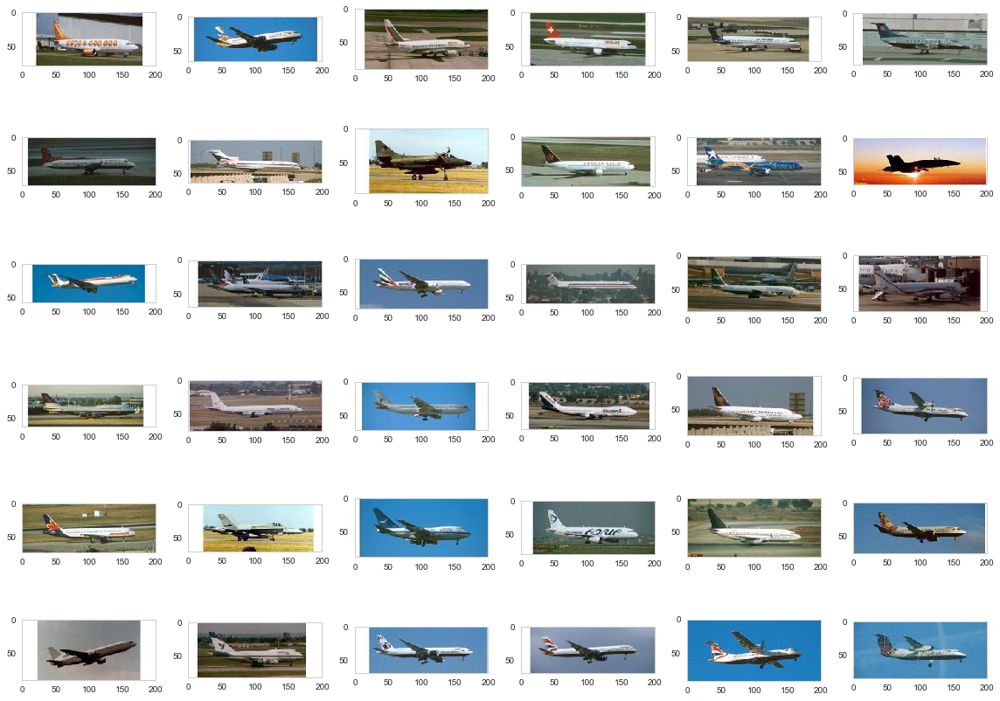

Cluster 1: n_samples 798


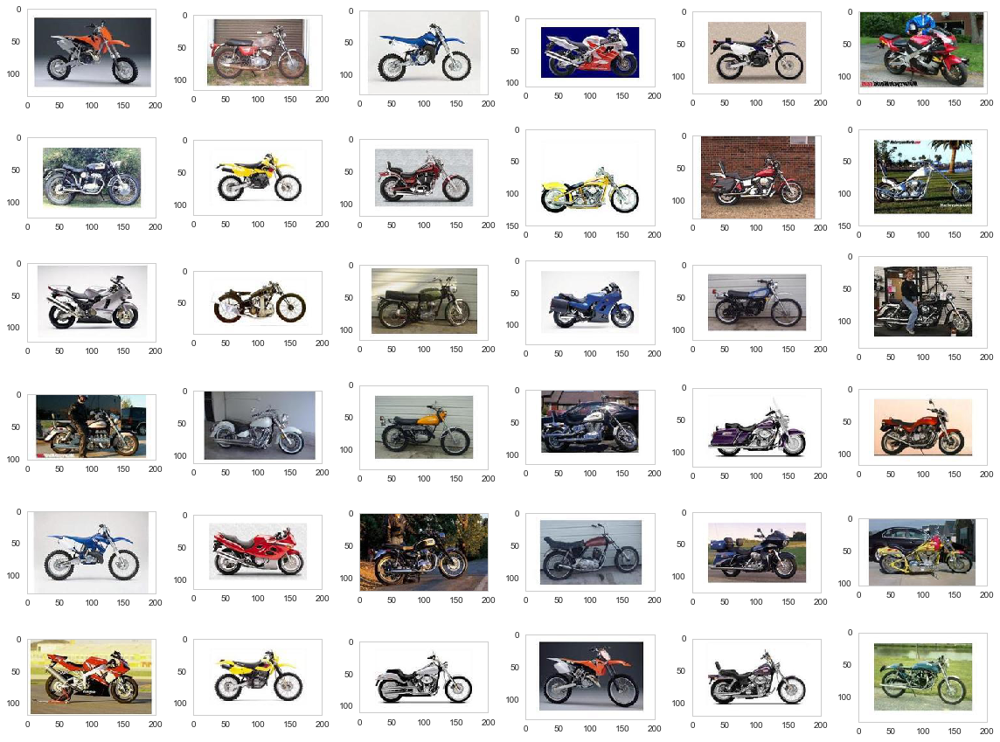

Cluster 10: n_samples 321


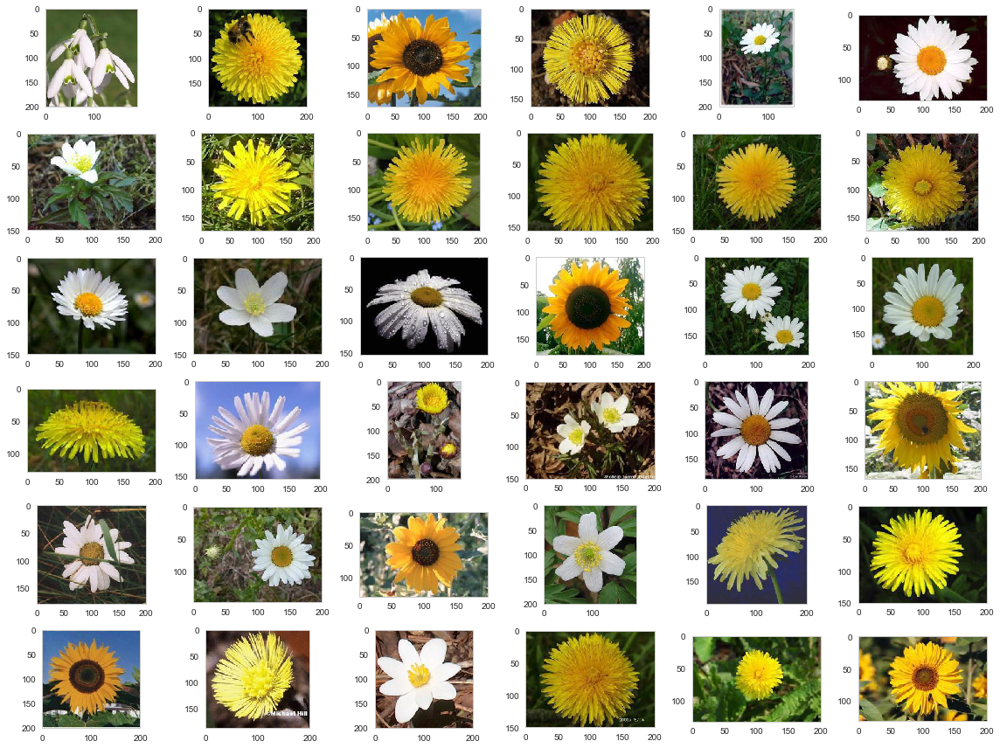

Cluster 2: n_samples 1151


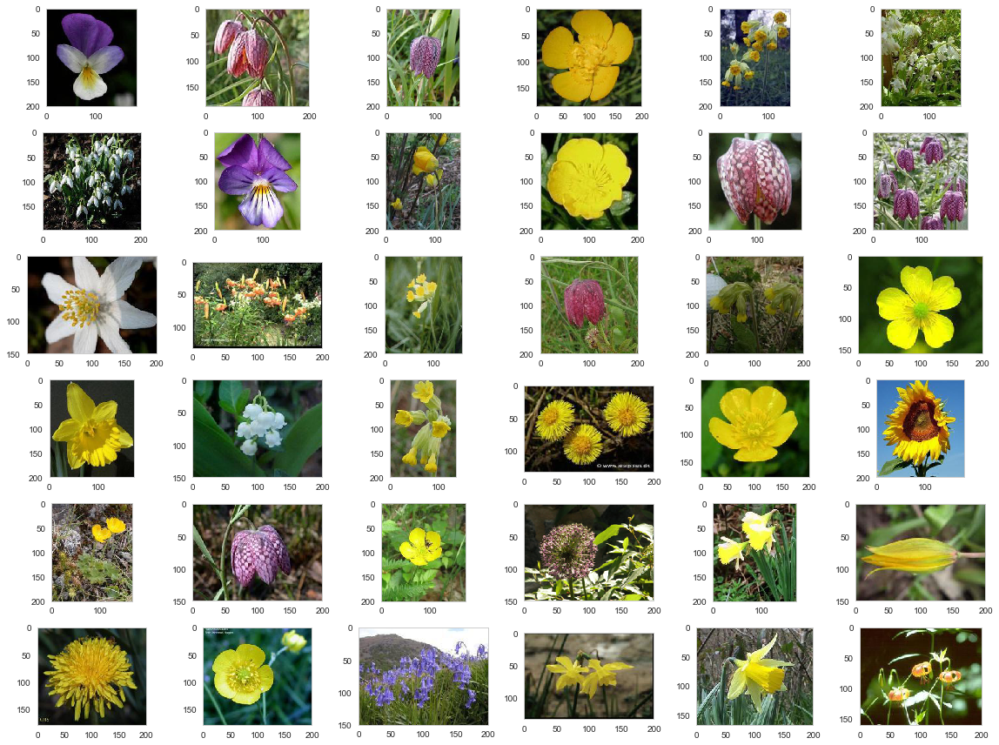

Cluster 3: n_samples 741


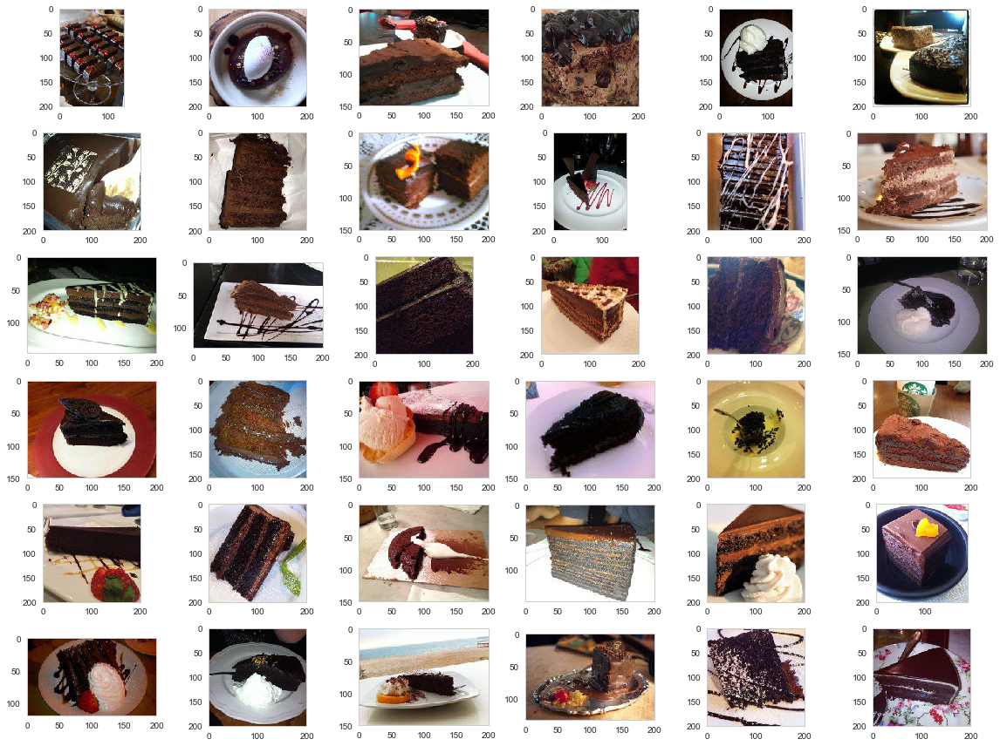

Cluster 4: n_samples 526


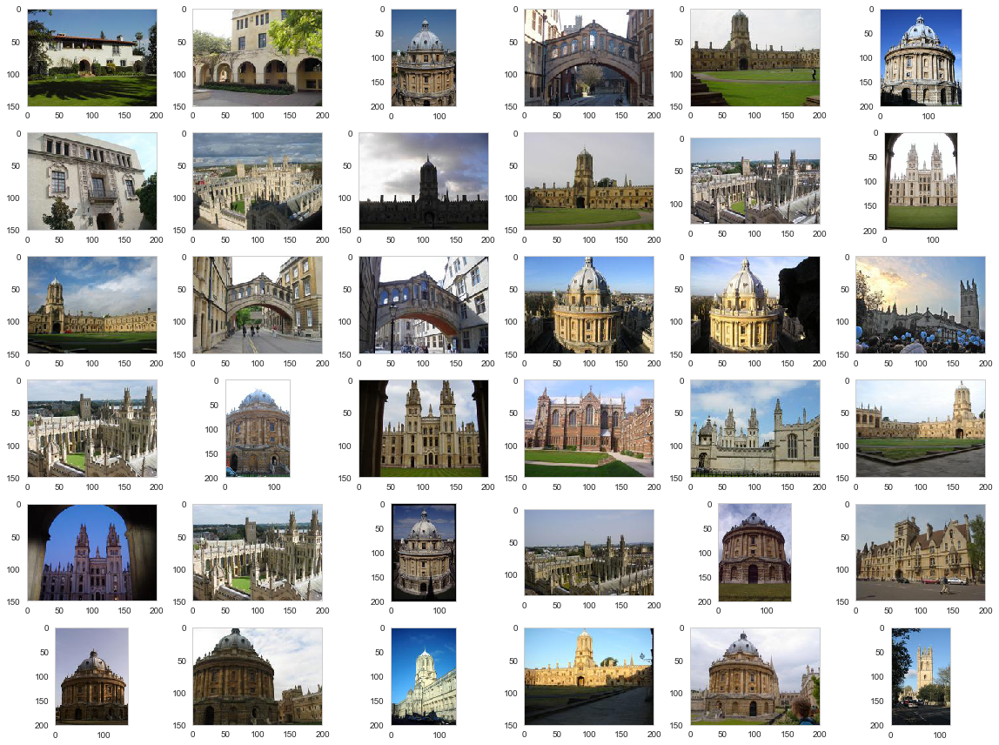

Cluster 5: n_samples 529


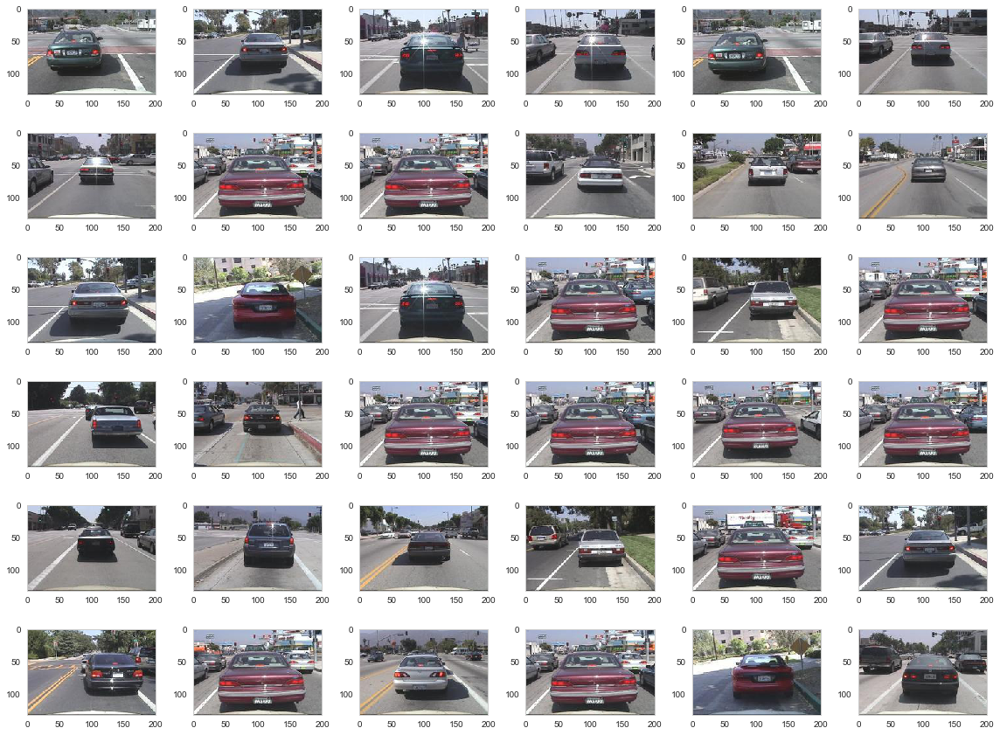

Cluster 6: n_samples 432


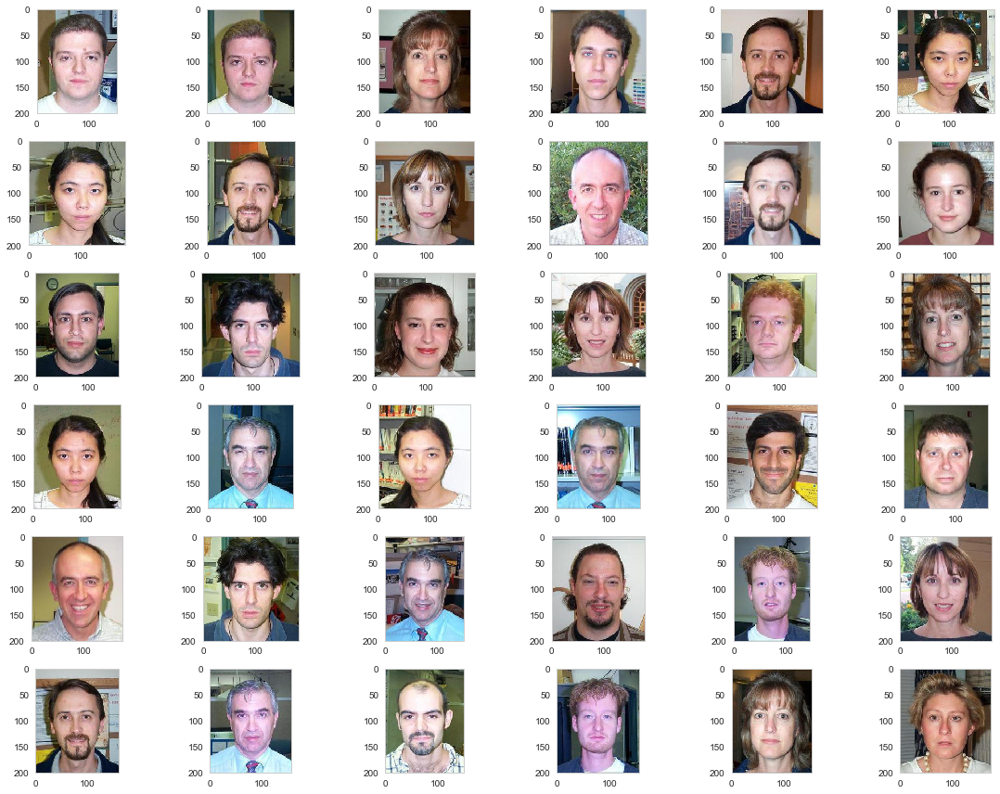

Cluster 7: n_samples 426


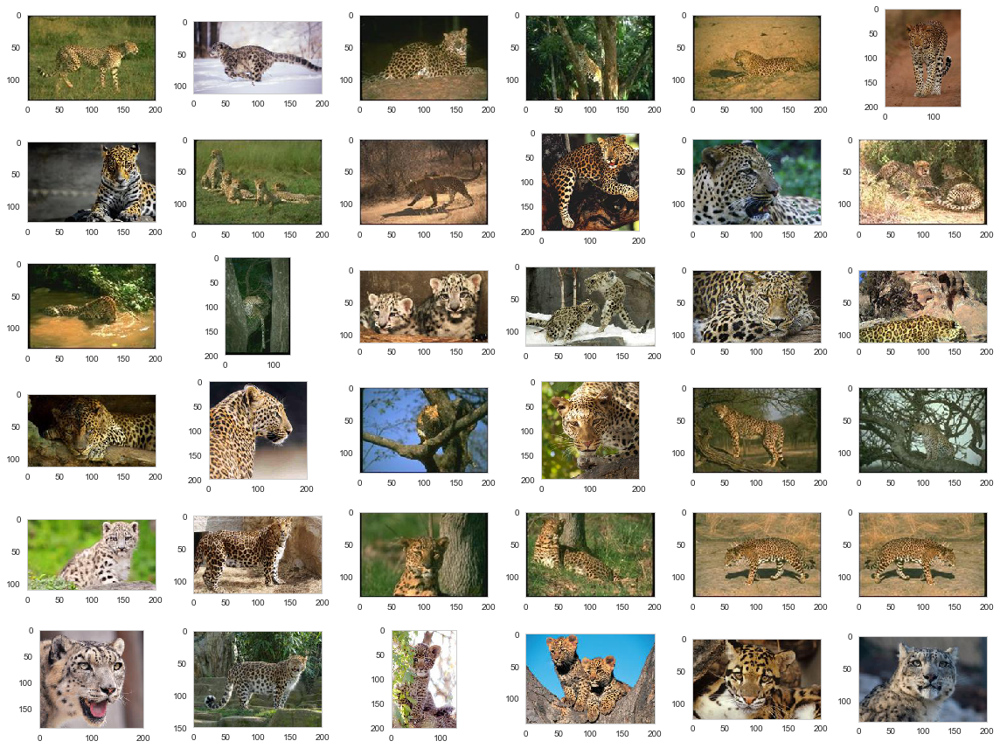

Cluster 8: n_samples 710


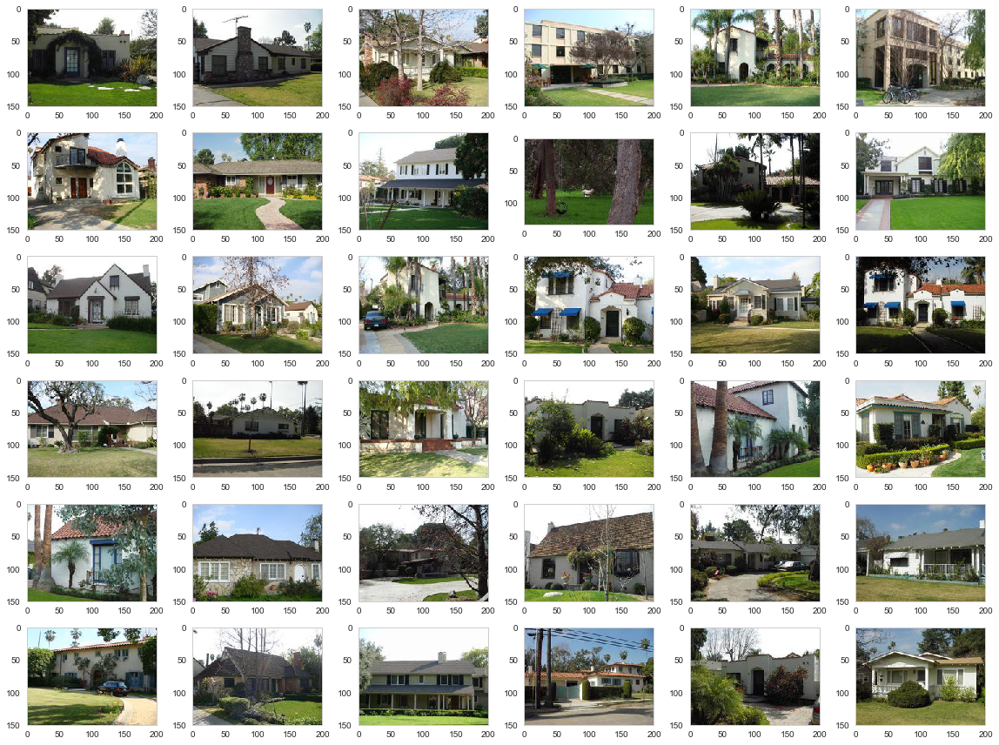

Cluster 9: n_samples 459


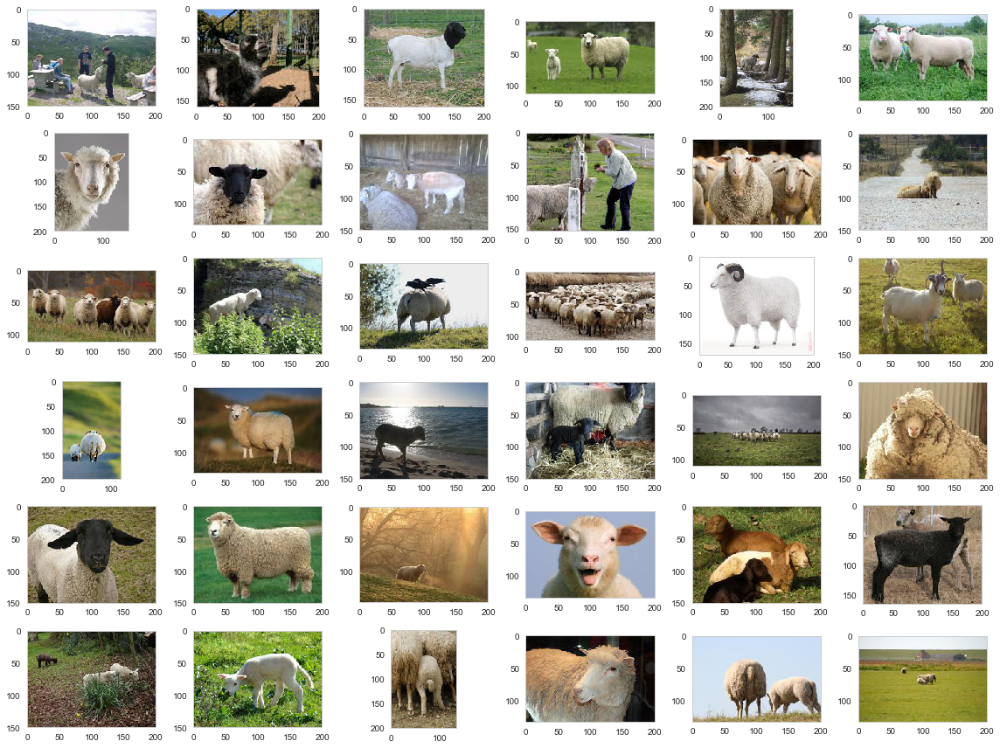

In [16]:
out_dir = os.path.join(CLUSTER_OUT_ROOT, 'final_results')

clusters = os.listdir(out_dir)
grid_size = 6*6

for c in sorted(clusters):
    cluster_path = os.path.join(out_dir, c)
    print("Cluster %s: n_samples %d" % (c, len(os.listdir(cluster_path))))
    show_random_sample(cluster_path, grid_size)
    plt.savefig('./cluster_%s.png' % c)
    plt.show()

## Evaluation on labeled datasets

Run all models on all labeled datasets and print results

In [8]:
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics.pairwise import cosine_distances, cosine_similarity
from sklearn.decomposition import PCA
from src.modules.dataset import *
from src.modules.dataset_utils import *

all_results = {}
similarity = cosine_similarity 


models = [inceptionv3.InceptionNet()]#, inceptionv4.InceptionNetV4(), resnet50.Resnet50()]
for model in models:
    results = []
    for name, path in dataset_imgs_root.items():
        n_samples = len(os.listdir(path))
        k = get_n_different_classes(name)

        if str(k) == 'unknown':
            # skip unlabeled datasets
            continue

        logging.info("Running %s", name)
        ds = ImageDataset(dataset_imgs_root[name])

        # get features
        features_path = pickled_features_path(name, features_extraction_model)
        if os.path.exists(features_path):
            # restore, skip loading in case of large dataset
            ds.load_features(features_path, skip_img_load=True)
        else:
            ds.extract_features(features_extraction_model)
            ds.store_features(features_path)

        pca = PCA().fit(ds.features)
        summary = pca_summary(pca, ds.features)
        n_components = summary[summary.sdev**2 > 1].shape[0]
        transformedX = PCA(n_components).fit_transform(ds.features)

        clustering = KMeans(n_jobs=-1, n_clusters=k)
        clustering.fit(transformedX)

        # dump results to dir
        out_dir = os.path.join(CLUSTER_OUT_ROOT, '%s_%s' % (name, features_extraction_model.name))
        ds.save_clusters_to_file(out_dir, clustering.labels_, force_reload=True)
        cluster_model_name = str(clustering).split('(')[0]

        results.append(compare_cluster_to_labels(out_dir, name))
    all_results["%s_%s" % (model.name, cluster_model_name)] = results

2017-05-19 19:04:19 INFO     Running cats_dogs


100%|██████████| 2/2 [06:22<00:00, 187.30s/it]


2017-05-19 19:11:30 INFO     Running cifar10


 80%|████████  | 8/10 [00:37<00:09,  4.76s/it]/home/mratkovic/mozgalo/lib/python3.5/site-packages/skimage/io/_io.py:132: UserWarning: /home/mratkovic/mozgalo2017/src/modules/../../clusters/cifar10_inceptionv3/8/21597.jpg is a low contrast image
  warn('%s is a low contrast image' % fname)
100%|██████████| 10/10 [00:45<00:00,  4.38s/it]


2017-05-19 19:13:49 INFO     Running stl10


/home/mratkovic/mozgalo/lib/python3.5/site-packages/sklearn/metrics/classification.py:1113: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/mratkovic/mozgalo/lib/python3.5/site-packages/sklearn/metrics/classification.py:1113: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
100%|██████████| 10/10 [00:08<00:00,  1.24it/s]


In [11]:
# merge results
merged = {k: pd.concat(r) for k, r in all_results.items()}



In [13]:
merged['inceptionv3_KMeans']

,dataset,accuracy,precision,recall,F1,ARI
0,cats_dogs,0.97988,0.980522,0.97988,0.979873,0.921136
0,cifar10,0.54880,0.512189,0.54880,0.524237,0.313777
0,stl10,0.90620,0.925623,0.90620,0.909280,0.796469


# Hierarchical clustering

- Hierarchical clustering je koristen u nastavku kako bi se detaljnlje proucili podaci
- Dendrogram prikazuje hijerarhijski odnos i udaljenosti medu grupama

In [18]:
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import linkage,  dendrogram

features = PCA(n_components).fit_transform(dataset.features)
# generate the linkage matrix
with Timer("Linkage"):
    Z = linkage(dataset.features, 'ward')

2017-05-19 19:24:17 INFO     Duration Linkage 48 s


In [ ]:
# Plot dendrogram    
plt.figure(figsize=(14, 8))
plt.xlabel('group size')
plt.ylabel('distance')
dendrogram(
    Z,
    truncate_mode='lastp',  # show only the last p merged clusters
    p=14,  # show only the last p merged clusters
    leaf_rotation=90.,
    leaf_font_size=25.,
    show_contracted=True,    
)

plt.show()


In [ ]:
from sklearn.cluster import AgglomerativeClustering

# try different cluster sizes and dump results to directory
# so we can later observe which clusters represent what in dendrogram
for k in tqdm(range(5, 15)):
    model = AgglomerativeClustering(k)
    model = model.fit(dataset.features)

    # dump results to dir
    out_dir = os.path.join(CLUSTER_OUT_ROOT, 'hac', 'hac_%s' % k)
    dataset.save_clusters_to_file(out_dir, model.labels_)

In [ ]:
#print hac clusters by size so they can be matched with dendrogram above
root_dir = '../clusters/hac/'

for grouping_dir in sorted(os.listdir(root_dir)):
    grouping_path = os.path.join(root_dir, grouping_dir)
    clusters = os.listdir(grouping_path)
    
    print(grouping_dir, " N_groups: ", len(clusters))
    for group_dir in sorted(os.listdir(grouping_path)):
        group_path = os.path.join(grouping_path, group_dir)
        print('\t', group_dir, "samples:", len(os.listdir(group_path)))
    print()